In [18]:
from tensorflow.keras.layers import (
    GlobalAveragePooling2D, Conv2D, Lambda, Concatenate, Multiply, UpSampling2D, concatenate
)
from tensorflow.keras.models import Model
import tensorflow as tf
import numpy as np
import cv2
import matplotlib.pyplot as plt

def dual_attention(inputs):
    channels = inputs.shape[-1]

    # Channel Attention
    channel_avg = GlobalAveragePooling2D(keepdims=True)(inputs)
    channel_avg = Conv2D(channels // 8, kernel_size=1, activation='relu')(channel_avg)
    channel_avg = Conv2D(channels, kernel_size=1, activation='sigmoid')(channel_avg)

    # Spatial Attention with output shape hints
    def reduce_mean(x):
        return tf.reduce_mean(x, axis=-1, keepdims=True)

    def reduce_max(x):
        return tf.reduce_max(x, axis=-1, keepdims=True)

    def spatial_shape(input_shape):
        return input_shape[:-1] + (1,)

    spatial_avg = Lambda(reduce_mean, output_shape=spatial_shape)(inputs)
    spatial_max = Lambda(reduce_max, output_shape=spatial_shape)(inputs)
    spatial = Concatenate()([spatial_avg, spatial_max])
    spatial = Conv2D(1, kernel_size=7, padding='same', activation='sigmoid')(spatial)

    # Apply attention
    attention = Multiply()([channel_avg, spatial])
    return Multiply()([inputs, attention])


In [19]:
def unet_da(input_shape=(256, 512, 3), num_classes=34):
    base_model = tf.keras.applications.ResNet50(
        include_top=False,
        weights='imagenet',
        input_shape=input_shape
    )

    s1 = base_model.get_layer('conv1_relu').output       # 128x256
    s2 = base_model.get_layer('conv2_block3_out').output # 64x128
    s3 = base_model.get_layer('conv3_block4_out').output # 32x64
    s4 = base_model.get_layer('conv4_block6_out').output # 16x32

    d1 = UpSampling2D(2)(s4)
    d1 = concatenate([d1, s3])
    d1 = Conv2D(512, 3, padding='same', activation='relu')(d1)
    d1 = dual_attention(d1)

    d2 = UpSampling2D(2)(d1)
    d2 = concatenate([d2, s2])
    d2 = Conv2D(256, 3, padding='same', activation='relu')(d2)
    d2 = dual_attention(d2)

    d3 = UpSampling2D(2)(d2)
    d3 = concatenate([d3, s1])
    d3 = Conv2D(128, 3, padding='same', activation='relu')(d3)
    d3 = dual_attention(d3)

    d4 = UpSampling2D(2)(d3)
    outputs = Conv2D(num_classes, 1, activation='softmax')(d4)

    return Model(inputs=base_model.input, outputs=outputs)


In [20]:
# Rebuild model architecture
model = unet_da()

# Load only the weights
model.load_weights('/kaggle/input/daunet/keras/default/1/cityscapes_unet_da.keras')


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [24]:
def preprocess_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    resized = cv2.resize(img, (512, 256))
    normalized = (resized / 127.5) - 1.0
    return np.expand_dims(normalized, axis=0)

def predict(image_path):
    input_tensor = preprocess_image(image_path)
    prediction = model.predict(input_tensor)
    mask = tf.argmax(prediction[0], axis=-1).numpy().astype(np.uint8)
    return mask


In [33]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random

def visualize_with_viridis(folder_path, predict_fn, num_images=50):
    image_files = [os.path.join(folder_path, f)
                   for f in os.listdir(folder_path)
                   if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    selected_files = random.sample(image_files, min(num_images, len(image_files)))

    plt.figure(figsize=(15, 5 * num_images))

    for idx, image_path in enumerate(selected_files):
        # Load and preprocess image
        original = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)
        mask = predict_fn(image_path)  # should return 2D array with class indices

        # Resize mask to match original if needed
        if mask.shape[:2] != original.shape[:2]:
            mask = cv2.resize(mask, (original.shape[1], original.shape[0]), interpolation=cv2.INTER_NEAREST)

        # Normalize mask for colormap
        mask_norm = mask.astype(np.float32) / mask.max() if mask.max() > 0 else mask.astype(np.float32)

        # Generate viridis colormap
        mask_colored = plt.cm.viridis(mask_norm)[:, :, :3]  # remove alpha
        mask_colored = (mask_colored * 255).astype(np.uint8)

        # Ensure mask_colored matches original size
        if mask_colored.shape[:2] != original.shape[:2]:
            mask_colored = cv2.resize(mask_colored, (original.shape[1], original.shape[0]), interpolation=cv2.INTER_LINEAR)

        # Create overlay
        overlay = cv2.addWeighted(original, 0.6, mask_colored, 0.4, 0)

        # Plot Original
        plt.subplot(num_images, 3, idx * 3 + 1)
        plt.imshow(original)
        plt.title("Original")
        plt.axis('off')

        # Plot Mask
        plt.subplot(num_images, 3, idx * 3 + 2)
        plt.imshow(mask, cmap='viridis')
        plt.title("Prediction Mask")
        plt.axis('off')

        # Plot Overlay
        plt.subplot(num_images, 3, idx * 3 + 3)
        plt.imshow(overlay)
        plt.title("Overlay")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 998ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 961ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 975ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 983ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 974ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 967ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 996ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 986ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 996ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 987ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 971ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 977ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 963ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 976ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 988ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 965ms/step
1/1 ━━━━━━━━━━━━

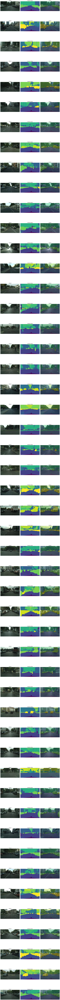

In [34]:
visualize_with_viridis("/kaggle/input/cityscapestestimageberlin", predict)
